In [1]:
%%capture
!pip install -U diffusers transformers accelerate safetensors
!pip install -U xformers --index-url https://download.pytorch.org/whl/cu121 triton

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import torch
from diffusers import StableDiffusionXLPipeline, UNet2DConditionModel, EulerDiscreteScheduler
from huggingface_hub import hf_hub_download
from safetensors.torch import load_file

base = "stabilityai/stable-diffusion-xl-base-1.0"
repo = "ByteDance/SDXL-Lightning"

checkpoints = {
    "1-Step" : ["sdxl_lightning_1step_unet_x0.safetensors", 1],
    "2-Step" : ["sdxl_lightning_2step_unet.safetensors", 2],
    "4-Step" : ["sdxl_lightning_4step_unet.safetensors", 4],
    "8-Step" : ["sdxl_lightning_8step_unet.safetensors", 8],
}

model_size = '4-Step'
ckpt = checkpoints[model_size][0]
num_inference_steps = checkpoints[model_size][1]

unet = UNet2DConditionModel.from_config(base, subfolder="unet").to("cuda", torch.float16)
unet.load_state_dict(load_file(hf_hub_download(repo, ckpt), device="cuda"))
pipe = StableDiffusionXLPipeline.from_pretrained(base,
                                                 unet=unet,
                                                 torch_dtype=torch.float16,
                                                 variant="fp16").to("cuda")

# pipe.scheduler = EulerDiscreteScheduler.from_config(pipe.scheduler.config, timestep_spacing="trailing")

pipe.enable_xformers_memory_efficient_attention()
pipe.enable_model_cpu_offload()
pipe.enable_vae_slicing()


The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/diffusers/configuration_utils.py:245: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.If you were trying to load a model, please use <class 'diffusers.models.unets.unet_2d_condition.UNet2DConditionModel'>.load_config(...) followed by <class 'diffusers.models.unets.unet_2d_condition.UNet2DConditionModel'>.from_config(...) instead. Otherwise, please make sure to pass a configuration dictionary instead. This functionality will be removed in v1.0.0.
  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:99: UserWarning: 
Error while fetching `HF_TOKEN` secret value from your vault: 'Requesting secret HF_TOKEN timed out. Secrets can only be fetched when running from the Colab UI.'.
You are not authenticated with the Hugging Face Hub in this notebook.
If the error persists, please let us know by opening an is

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

sdxl_lightning_4step_unet.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [3]:
pipe.scheduler

EulerDiscreteScheduler {
  "_class_name": "EulerDiscreteScheduler",
  "_diffusers_version": "0.29.2",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "final_sigmas_type": "zero",
  "interpolation_type": "linear",
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "rescale_betas_zero_snr": false,
  "sample_max_value": 1.0,
  "set_alpha_to_one": false,
  "sigma_max": null,
  "sigma_min": null,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "leading",
  "timestep_type": "discrete",
  "trained_betas": null,
  "use_karras_sigmas": false
}

In [4]:
pipe.scheduler.config

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.00085),
            ('beta_end', 0.012),
            ('beta_schedule', 'scaled_linear'),
            ('trained_betas', None),
            ('prediction_type', 'epsilon'),
            ('interpolation_type', 'linear'),
            ('use_karras_sigmas', False),
            ('sigma_min', None),
            ('sigma_max', None),
            ('timestep_spacing', 'leading'),
            ('timestep_type', 'discrete'),
            ('steps_offset', 1),
            ('rescale_betas_zero_snr', False),
            ('final_sigmas_type', 'zero'),
            ('_use_default_values',
             ['timestep_type',
              'sigma_max',
              'final_sigmas_type',
              'sigma_min',
              'rescale_betas_zero_snr']),
            ('_class_name', 'EulerDiscreteScheduler'),
            ('_diffusers_version', '0.29.2'),
            ('clip_sample', False),
            ('sample_max_value', 1.0),
            ('set_a

  0%|          | 0/4 [00:00<?, ?it/s]

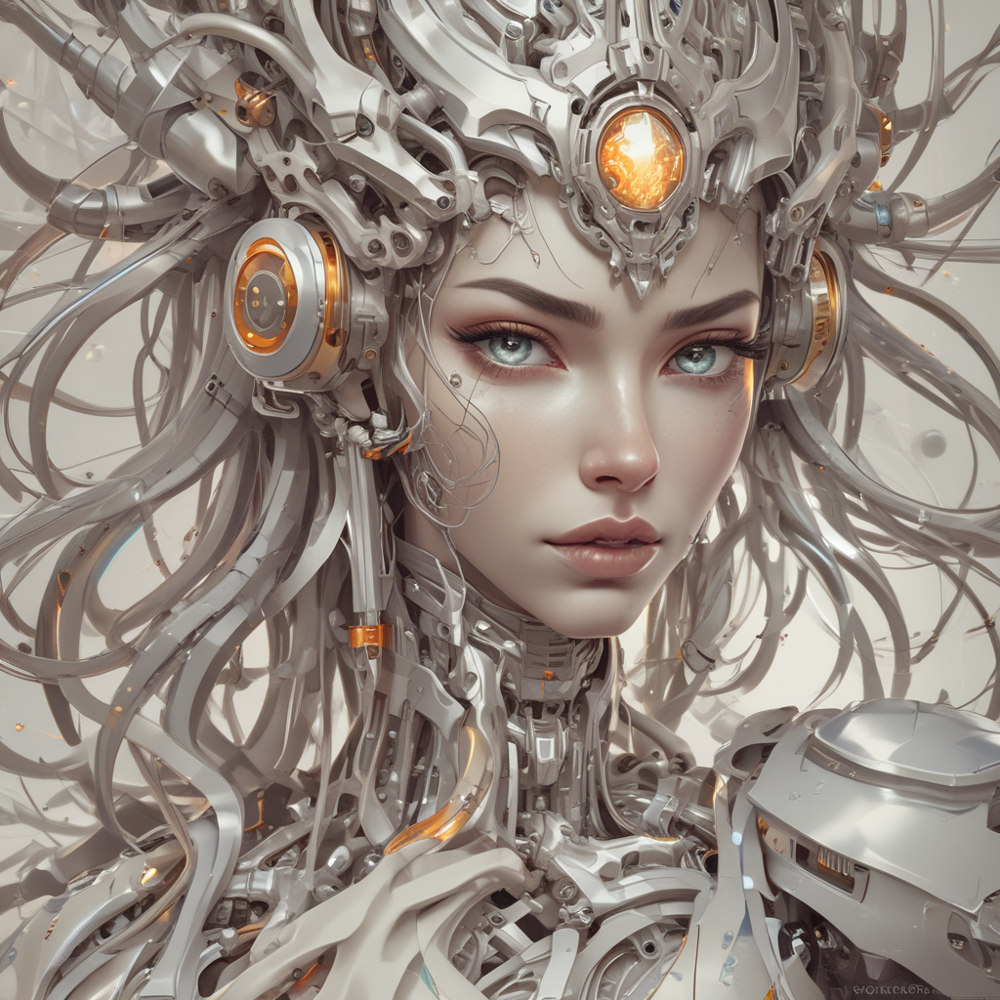

In [5]:
prompt = """beautiful anime girl, sorceress, flame magic, cyborg, sci-fi, futuristic, robot lady, futuristic beauty, perfect eyes robot anatomy, epic,
        high detailed face, beautiful body, highly detailed, photorealistic concept art, anime art, digital painting,
        by Yanjun Cheng, Charlie Bowater, Splash art, trending on Artstation, 8k, intricate details"""

negative_prompt = """deformed fingers, deformed neck, blurry hands, deformed hands, twisted fingers, poorly drawn hands, 2 heads, elongated body, 2 faces, signature, watermark, double image,
                     long neck, ugly, missing limb, ugly, over saturated, grain, blurry, bad anatomy, disfigured,
                     poorly drawn face, mutation, disconnected limbs, out of focus, long body, disgusting, poorly drawn, mutilated, mangled, extra fingers,
                     gross proportions, missing arms, mutated hands, mutilated hands, cloned face, missing legs,
                     poorly drawn hands, poorly drawn, poorly drawn face, out of frame, extra limbs,
                     deformed, body out of frame, blurry, bad anatomy, blurred, grainy,
                     cut off, draft, duplicate, coppy, multi, two faces"""

torch.cuda.empty_cache()
torch.cuda.synchronize()

generator = torch.Generator("cuda").manual_seed(592779500)

image = pipe(prompt, negative_prompt=negative_prompt, num_images_per_prompt=1, num_inference_steps=4, guidance_scale=1, generator=generator).images[0]
image

  0%|          | 0/4 [00:00<?, ?it/s]

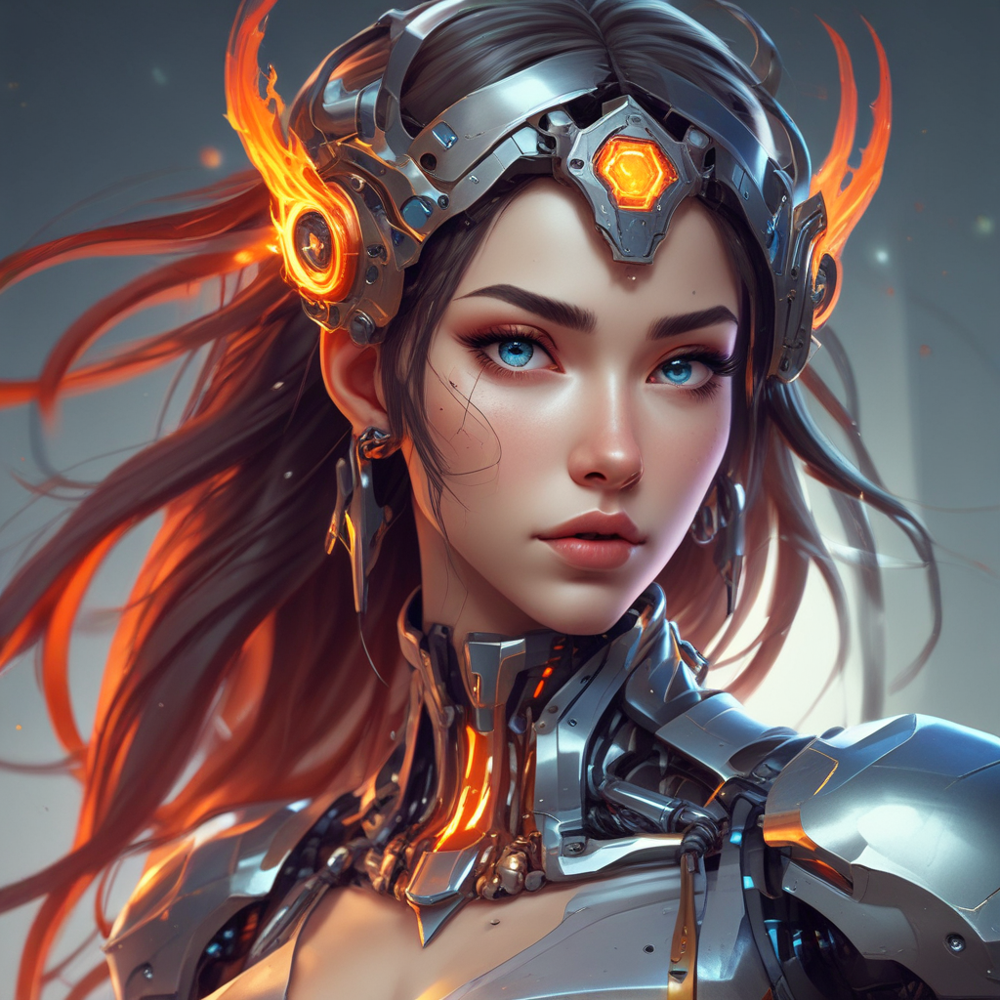

In [6]:
import copy
scheduler_config_original = copy.deepcopy(pipe.scheduler.config)

scheduler_config = copy.deepcopy(scheduler_config_original)
pipe.scheduler = EulerDiscreteScheduler.from_config(scheduler_config, timestep_spacing="trailing")

torch.cuda.empty_cache()
torch.cuda.synchronize()

generator = torch.Generator("cuda").manual_seed(592779500)

image = pipe(prompt, negative_prompt=negative_prompt, num_images_per_prompt=1, num_inference_steps=4, guidance_scale=1, generator=generator).images[0]
image

In [7]:
def images_show(images, title, values, rows=2, cols=2, height=20):
    fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize=(30, height))

    for i in range(len(images)):
        row_idx = i // cols
        col_idx = i % cols

        axs[row_idx, col_idx].imshow(images[i])
        axs[row_idx, col_idx].set_title(f"{title}: {values[i]}")
        axs[row_idx, col_idx].axis('off')

        # for i, ax in enumerate(axs.flat):
        #   if i < len(images):
        #       ax.imshow(images[i])
        #       ax.set_title(f"seed: {seeds[i]}")
        #   ax.axis('off')

    plt.tight_layout()
    plt.show()

seed: 816634738


  0%|          | 0/4 [00:00<?, ?it/s]

seed: 984150535


  0%|          | 0/4 [00:00<?, ?it/s]

seed: -386353721


  0%|          | 0/4 [00:00<?, ?it/s]

seed: 25900679


  0%|          | 0/4 [00:00<?, ?it/s]

seed: -502326675


  0%|          | 0/4 [00:00<?, ?it/s]

seed: 431203318


  0%|          | 0/4 [00:00<?, ?it/s]

seed: 222605734


  0%|          | 0/4 [00:00<?, ?it/s]

seed: 484396429


  0%|          | 0/4 [00:00<?, ?it/s]

seed: 922592767


  0%|          | 0/4 [00:00<?, ?it/s]

seed: 850201548


  0%|          | 0/4 [00:00<?, ?it/s]

seed: -18045871


  0%|          | 0/4 [00:00<?, ?it/s]

seed: -203208457


  0%|          | 0/4 [00:00<?, ?it/s]

seed: -268239736


  0%|          | 0/4 [00:00<?, ?it/s]

seed: -373360133


  0%|          | 0/4 [00:00<?, ?it/s]

seed: -123092235


  0%|          | 0/4 [00:00<?, ?it/s]

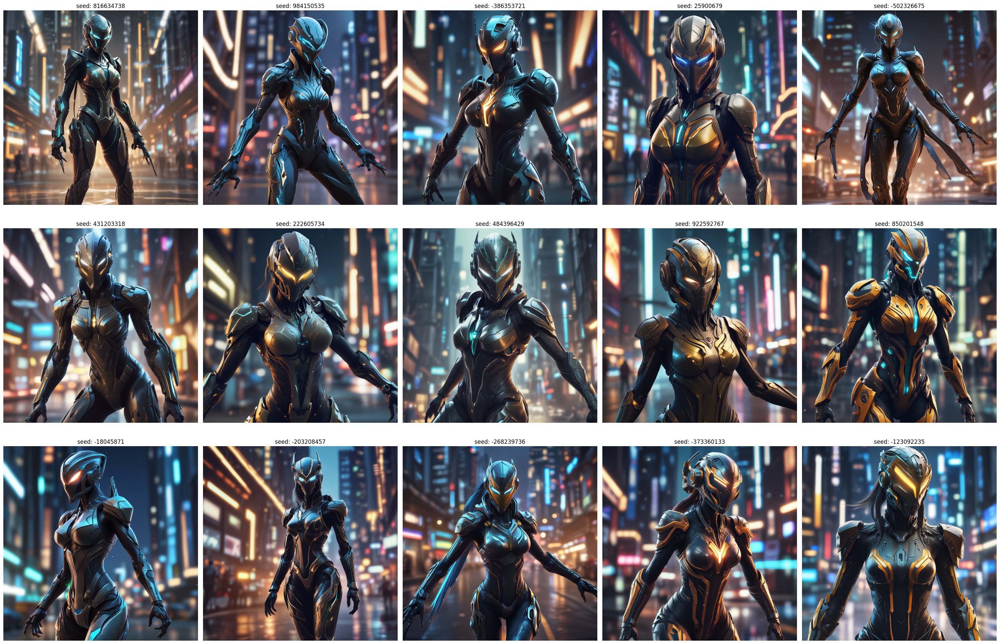

In [8]:
all_seeds=[]
all_images=[]

for i in range(1, 16):
    prompt = """Detailed mask, female figure in exo costume, in motion, hip view, sci-fi style, hawk, warframe, dark setting, intricate details, rogue, slender young figure, battle armor, futuristic city background,
                amazing image quality in 8k, teflon surface, segmented armor, octane rendering, energy lights, neon, matt surface, smooth surface"""

    torch.cuda.empty_cache()
    torch.cuda.synchronize()


    torch_seed = np.random.randint(low=-1000000000, high=1000000000, dtype=np.int64)
    print(f'seed: {torch_seed}')
    generator = torch.Generator("cuda").manual_seed(int(torch_seed))

    images = pipe(prompt, generator=generator, guidance_scale=0, num_inference_steps=4).images

    all_seeds.append(int(torch_seed))
    all_images.extend(images)

images_show(all_images, 'seed', all_seeds, rows=3, cols=5)

In [9]:
def images_schedulers_show(images, title, rows=2, cols=2, height=20):
    fig, axs = plt.subplots(nrows=rows, ncols=cols, figsize=(30, height))

    for i in range(len(images)):
        row_idx = i // cols
        col_idx = i % cols

        axs[row_idx, col_idx].imshow(images[i])
        axs[row_idx, col_idx].set_title(f"{title[i]}")
        axs[row_idx, col_idx].axis('off')

    plt.tight_layout()
    plt.show()

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/diffusers/image_processor.py:111: RuntimeWarning: invalid value encountered in cast
  images = (images * 255).round().astype("uint8")


  0%|          | 0/4 [00:00<?, ?it/s]

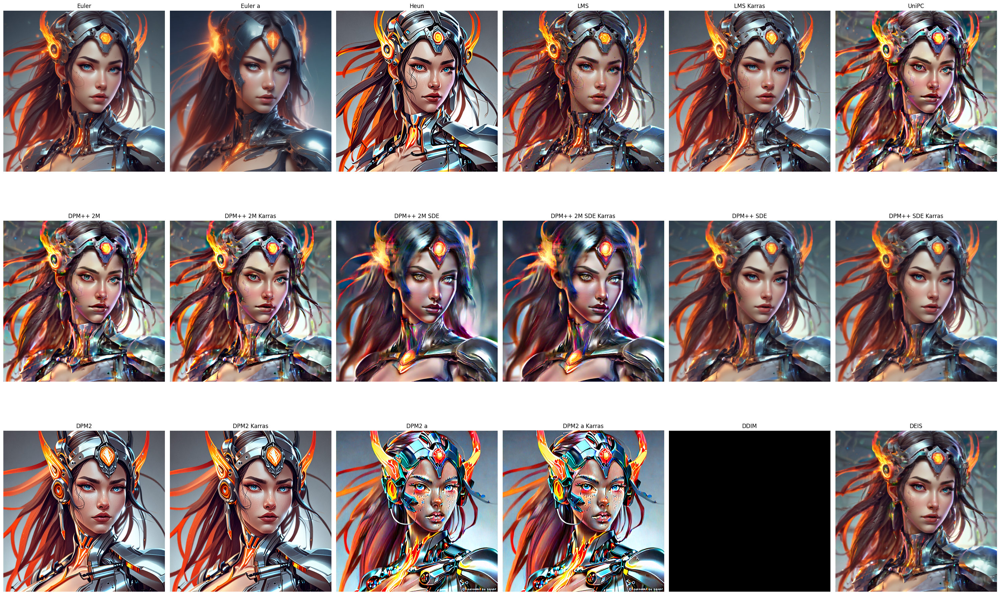

In [10]:
import copy
from diffusers import (
    KDPM2DiscreteScheduler,
    LMSDiscreteScheduler,
    KDPM2AncestralDiscreteScheduler,
    HeunDiscreteScheduler,
    PNDMScheduler,
    DEISMultistepScheduler,
    DPMSolverSDEScheduler,
    DDPMScheduler,
    DPMSolverSinglestepScheduler,
    EulerAncestralDiscreteScheduler,
    DDIMScheduler,
    DPMSolverMultistepScheduler,
    EulerDiscreteScheduler,
    UniPCMultistepScheduler
)


scheduler_config_original = copy.deepcopy(pipe.scheduler.config)

all_schedulers = ['Euler', 'Euler a', 'Heun', 'LMS', 'LMS Karras', 'UniPC',
                  'DPM++ 2M', 'DPM++ 2M Karras', 'DPM++ 2M SDE', 'DPM++ 2M SDE Karras', 'DPM++ SDE', 'DPM++ SDE Karras',
                  'DPM2', 'DPM2 Karras', 'DPM2 a', 'DPM2 a Karras', 'DDIM', 'DEIS']
all_images = []

for scheduler in all_schedulers:
    scheduler_config = copy.deepcopy(pipe.scheduler.config)

    if scheduler == 'Euler':
        pipe.scheduler = EulerDiscreteScheduler.from_config(scheduler_config)

    elif scheduler == 'Euler a':
        pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(scheduler_config)

    elif scheduler == 'UniPC':
        pipe.scheduler = UniPCMultistepScheduler.from_config(scheduler_config)

    elif scheduler == 'Heun':
        pipe.scheduler = HeunDiscreteScheduler.from_config(scheduler_config)

    elif scheduler == 'LMS':
        pipe.scheduler = LMSDiscreteScheduler.from_config(scheduler_config)

    elif scheduler == 'LMS Karras':
        pipe.scheduler = LMSDiscreteScheduler.from_config(scheduler_config, use_karras_sigmas=True)

    elif scheduler == 'DDIM':
        pipe.scheduler = DDIMScheduler.from_config(scheduler_config, rescale_betas_zero_snr=True)

    elif scheduler == 'DPM++ 2M':
        pipe.scheduler = DPMSolverMultistepScheduler.from_config(scheduler_config, algorithm_type="dpmsolver++")

    elif scheduler == 'DPM++ 2M Karras':
        pipe.scheduler = DPMSolverMultistepScheduler.from_config(scheduler_config, algorithm_type="dpmsolver++", use_karras_sigmas=True)

    elif scheduler == 'DPM++ 2M SDE':
        pipe.scheduler = DPMSolverMultistepScheduler.from_config(scheduler_config, algorithm_type="sde-dpmsolver++")

    elif scheduler == 'DPM++ 2M SDE Karras':
        pipe.scheduler = DPMSolverMultistepScheduler.from_config(scheduler_config, algorithm_type="sde-dpmsolver++", use_karras_sigmas=True)

    elif scheduler == 'DPM++ SDE':
        pipe.scheduler = DPMSolverSinglestepScheduler.from_config(scheduler_config, algorithm_type="dpmsolver++", lower_order_final=True)

    elif scheduler == 'DPM++ SDE Karras':
        pipe.scheduler = DPMSolverSinglestepScheduler.from_config(scheduler_config, algorithm_type="dpmsolver++", use_karras_sigmas=True, lower_order_final=True)

    elif scheduler == 'DPM2':
        pipe.scheduler = KDPM2DiscreteScheduler.from_config(scheduler_config)

    elif scheduler == 'DPM2 Karras':
        pipe.scheduler = KDPM2DiscreteScheduler.from_config(scheduler_config, use_karras_sigmas=True)

    elif scheduler == 'DPM2 a':
        pipe.scheduler = KDPM2AncestralDiscreteScheduler.from_config(scheduler_config)

    elif scheduler == 'DPM2 a Karras':
        pipe.scheduler = KDPM2AncestralDiscreteScheduler.from_config(scheduler_config, use_karras_sigmas=True)

    elif scheduler == 'DEIS':
        pipe.scheduler = DEISMultistepScheduler.from_config(scheduler_config, solver_order=2)



    prompt = """beautiful anime girl, sorceress, flame magic, cyborg, sci-fi, futuristic, robot lady, futuristic beauty, perfect eyes robot anatomy, epic,
            high detailed face, beautiful body, highly detailed, photorealistic concept art, anime art, digital painting,
            by Yanjun Cheng, Charlie Bowater, Splash art, trending on Artstation, 8k, intricate details"""

    negative_prompt = """deformed fingers, deformed neck, blurry hands, deformed hands, twisted fingers, poorly drawn hands, 2 heads, elongated body, 2 faces, signature, watermark, double image,
                         long neck, ugly, missing limb, ugly, over saturated, grain, blurry, bad anatomy, disfigured,
                         poorly drawn face, mutation, disconnected limbs, out of focus, long body, disgusting, poorly drawn, mutilated, mangled, extra fingers,
                         gross proportions, missing arms, mutated hands, mutilated hands, cloned face, missing legs,
                         poorly drawn hands, poorlydrawn, poorly drawn face, out of frame, extra limbs,
                         deformed, body out of frame, blurry, bad anatomy, blurred, grainy,
                         cut off, draft, duplicate, coppy, multi, two faces"""

    torch.cuda.empty_cache()
    torch.cuda.synchronize()

    generator = torch.Generator("cuda").manual_seed(592779500)

    images = pipe(prompt, negative_prompt=negative_prompt, generator=generator, guidance_scale=1, num_inference_steps=4).images

    all_images.extend(images)

images_schedulers_show(all_images, all_schedulers, rows=3, cols=6)